## Setup

You will need to make a copy of this notebook in your Google Drive before you can edit the homework files. You can do so with **File &rarr; Save a copy in Drive**.

In [ ]:
#@title mount your Google Drive

import os
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)

Mounted at /content/gdrive


In [ ]:
#@title set up mount symlink

DRIVE_PATH = '/content/gdrive/My\ Drive/cs285_f2023'
DRIVE_PYTHON_PATH = DRIVE_PATH.replace('\\', '')
if not os.path.exists(DRIVE_PYTHON_PATH):
  %mkdir $DRIVE_PATH

## the space in `My Drive` causes some issues,
## make a symlink to avoid this
SYM_PATH = '/content/cs285_f2023'
if not os.path.exists(SYM_PATH):
  !ln -s $DRIVE_PATH $SYM_PATH

In [ ]:
#@title apt install requirements

#@markdown Run each section with Shift+Enter

#@markdown Double-click on section headers to show code.

!apt update
!apt install -y --no-install-recommends \
        build-essential \
        curl \
        git \
        gnupg2 \
        make \
        cmake \
        ffmpeg \
        swig \
        libz-dev \
        unzip \
        zlib1g-dev \
        libglfw3 \
        libglfw3-dev \
        libxrandr2 \
        libxinerama-dev \
        libxi6 \
        libxcursor-dev \
        libgl1-mesa-dev \
        libgl1-mesa-glx \
        libglew-dev \
        libosmesa6-dev \
        lsb-release \
        ack-grep \
        patchelf \
        wget \
        xpra \
        xserver-xorg-dev \
        ffmpeg
!apt-get install python-opengl -y
!apt install xvfb -y

Get:1 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,626 B]
Hit:2 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease
Hit:3 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:4 http://security.ubuntu.com/ubuntu jammy-security InRelease [110 kB]
Get:5 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [119 kB]
Hit:6 http://archive.ubuntu.com/ubuntu jammy-backports InRelease
Get:7 http://security.ubuntu.com/ubuntu jammy-security/restricted amd64 Packages [1,784 kB]
Hit:8 https://ppa.launchpadcontent.net/c2d4u.team/c2d4u4.0+/ubuntu jammy InRelease
Get:9 http://archive.ubuntu.com/ubuntu jammy-updates/universe amd64 Packages [1,342 kB]
Hit:10 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:11 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Get:12 http://security.ubuntu.com/ubuntu jammy-security/main amd64 Packages [1,455 kB]
Get:13 http://security.ubuntu.com/ubuntu jamm

In [ ]:
%cd $SYM_PATH

/content/gdrive/My Drive/cs285_f2023


In [ ]:
!git clone https://github.com/berkeleydeeprlcourse/homework_fall2023.git
%cd homework_fall2023/hw2

fatal: destination path 'homework_fall2023' already exists and is not an empty directory.
/content/gdrive/My Drive/cs285_f2023/homework_fall2023/hw2


In [ ]:
#@title clone homework repo

%pip install -r requirements.txt
%pip install -e .

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.7/3.7 MB 24.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.6 MB 44.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.9/5.9 MB 63.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 125.4/125.4 kB 17.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.9/11.9 MB 82.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 887.5/887.5 MB 1.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.9/60.9 MB 10.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.8/211.8 kB 24.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 374.4/374.4 kB 37.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.3/18.3 MB 78.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 70.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━

Obtaining file:///content/gdrive/My%20Drive/cs285_f2023/homework_fall2023/hw2
  Preparing metadata (setup.py) ... done
  Running setup.py develop for cs285


In [ ]:
#@title set up virtual display

from pyvirtualdisplay import Display

display = Display(visible=0, size=(1400, 900))
display.start()

In [ ]:
#@title test virtual display

#@markdown If you see a video of a four-legged ant fumbling about, setup is complete!

import gym
from gym.wrappers import RecordVideo
import glob
import io
import base64
from IPython.display import HTML
from IPython import display as ipythondisplay

def show_video():
  mp4list = glob.glob('/content/video/*.mp4')
  if len(mp4list) > 0:
    mp4 = mp4list[0]
    video = io.open(mp4, 'r+b').read()
    encoded = base64.b64encode(video)
    ipythondisplay.display(HTML(data='''<video alt="test" autoplay
                loop controls style="height: 400px;">
                <source src="data:video/mp4;base64,{0}" type="video/mp4" />
             </video>'''.format(encoded.decode('ascii'))))
  else:
    print("Could not find video")


def wrap_env(env):
  env = RecordVideo(env, '/content/video')
  return env

env = wrap_env(gym.make("Ant-v4", render_mode='rgb_array'))

observation = env.reset()
for i in range(100):
    env.render()
    obs, rew, term, _ = env.step(env.action_space.sample() )
    if term:
      break;

env.close()
print('Loading video...')
show_video()

/usr/local/lib/python3.10/dist-packages/gym/core.py:317: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.10/dist-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.10/dist-packages/gym/utils/passive_env_checker.py:241: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):


Loading video...


## Run Policy Gradients

In [ ]:
#@title imports

import os
import time

from cs285.agents.pg_agent import PGAgent

%load_ext autoreload
%autoreload 2

In [ ]:
#@title runtime arguments

class Args:

  def __getitem__(self, key):
    return getattr(self, key)

  def __setitem__(self, key, val):
    setattr(self, key, val)

  def __contains__(self, key):
    return hasattr(self, key)

  env_name = 'CartPole-v0' #@param
  exp_name = 'q1_sb_rtg_na' #@param

  #@markdown main parameters of interest
  n_iter = 100 #@param {type: "integer"}

  ## PDF will tell you how to set ep_len
  ## and discount for each environment
  ep_len = 200 #@param {type: "integer"}
  discount = 0.95 #@param {type: "number"}

  reward_to_go = True #@param {type: "boolean"}
  nn_baseline = False #@param {type: "boolean"}
  gae_lambda = 1 #@param {type: "integer"}
  dont_standardize_advantages = False #@param {type: "boolean"}

  #@markdown batches and steps
  batch_size = 1000 #@param {type: "integer"}
  eval_batch_size = 400 #@param {type: "integer"}

  num_agent_train_steps_per_iter = 1 #@param {type: "integer"}
  learning_rate =  5e-3 #@param {type: "number"}

  #@markdown MLP parameters
  n_layers = 2 #@param {type: "integer"}
  size = 64 #@param {type: "integer"}

  #@markdown system
  save_params = False #@param {type: "boolean"}
  no_gpu = False #@param {type: "boolean"}
  which_gpu = 0 #@param {type: "integer"}
  seed = 1 #@param {type: "integer"}

  action_noise_std = 0 #@param {type: "integer"}

  #@markdown logging
  ## default is to not log video so
  ## that logs are small enough to be
  ## uploaded to gradscope
  video_log_freq =  -1#@param {type: "integer"}
  scalar_log_freq =  1#@param {type: "integer"}


args = Args()

## ensure compatibility with hw1 code
args['train_batch_size'] = args['batch_size']

if args['video_log_freq'] > 0:
  import warnings
  warnings.warn(
      '''\nLogging videos will make eventfiles too'''
      '''\nlarge for the autograder. Set video_log_freq = -1'''
      '''\nfor the runs you intend to submit.''')

In [ ]:
#@title create directory for logging

data_path = '''/content/cs285_f2023/''' \
            '''homework_fall2023/hw2/data'''

if not (os.path.exists(data_path)):
    os.makedirs(data_path)

logdir = args.exp_name + '_' + args.env_name + '_' + time.strftime("%d-%m-%Y_%H-%M-%S")
logdir = os.path.join(data_path, logdir)
args['logdir'] = logdir
if not(os.path.exists(logdir)):
    os.makedirs(logdir)

# 3. Policy Gradients

In [36]:
!python cs285/scripts/run_hw2.py --env_name CartPole-v0 -n 100 -b 1000 \
--exp_name cartpole

########################
logging outputs to  /content/gdrive/My Drive/cs285_f2023/homework_fall2023/hw2/cs285/scripts/../../data/q2_pg_cartpole_CartPole-v0_14-02-2024_18-43-53
########################
Using GPU id 0
/usr/local/lib/python3.10/dist-packages/gym/envs/registration.py:593: UserWarning: WARN: The environment CartPole-v0 is out of date. You should consider upgrading to version `v1`.
  logger.warn(
/usr/local/lib/python3.10/dist-packages/gym/core.py:317: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.10/dist-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  

In [ ]:
!python cs285/scripts/run_hw2.py --env_name CartPole-v0 -n 100 -b 1000 \
-rtg --exp_name cartpole_rtg

########################
logging outputs to  /content/gdrive/MyDrive/cs285_f2023/homework_fall2023/hw2/cs285/scripts/../../data/q2_pg_cartpole_rtg_CartPole-v0_08-02-2024_21-25-24
########################
Using GPU id 0
/usr/local/lib/python3.10/dist-packages/gym/envs/registration.py:593: UserWarning: WARN: The environment CartPole-v0 is out of date. You should consider upgrading to version `v1`.
  logger.warn(
/usr/local/lib/python3.10/dist-packages/gym/core.py:317: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.10/dist-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.

In [ ]:
!python cs285/scripts/run_hw2.py --env_name CartPole-v0 -n 100 -b 1000 \
-na --exp_name cartpole_na

########################
logging outputs to  /content/gdrive/MyDrive/cs285_f2023/homework_fall2023/hw2/cs285/scripts/../../data/q2_pg_cartpole_na_CartPole-v0_08-02-2024_21-27-59
########################
Using GPU id 0
/usr/local/lib/python3.10/dist-packages/gym/envs/registration.py:593: UserWarning: WARN: The environment CartPole-v0 is out of date. You should consider upgrading to version `v1`.
  logger.warn(
/usr/local/lib/python3.10/dist-packages/gym/core.py:317: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.10/dist-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.


In [ ]:
!python cs285/scripts/run_hw2.py --env_name CartPole-v0 -n 100 -b 1000 \
-rtg -na --exp_name cartpole_rtg_na

########################
logging outputs to  /content/gdrive/MyDrive/cs285_f2023/homework_fall2023/hw2/cs285/scripts/../../data/q2_pg_cartpole_rtg_na_CartPole-v0_08-02-2024_21-30-27
########################
Using GPU id 0
/usr/local/lib/python3.10/dist-packages/gym/envs/registration.py:593: UserWarning: WARN: The environment CartPole-v0 is out of date. You should consider upgrading to version `v1`.
  logger.warn(
/usr/local/lib/python3.10/dist-packages/gym/core.py:317: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.10/dist-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in futu

In [ ]:
!python cs285/scripts/run_hw2.py --env_name CartPole-v0 -n 100 -b 4000 \
--exp_name cartpole_lb

########################
logging outputs to  /content/gdrive/MyDrive/cs285_f2023/homework_fall2023/hw2/cs285/scripts/../../data/q2_pg_cartpole_lb_CartPole-v0_08-02-2024_21-32-34
########################
Using GPU id 0
/usr/local/lib/python3.10/dist-packages/gym/envs/registration.py:593: UserWarning: WARN: The environment CartPole-v0 is out of date. You should consider upgrading to version `v1`.
  logger.warn(
/usr/local/lib/python3.10/dist-packages/gym/core.py:317: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.10/dist-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.


In [ ]:
!python cs285/scripts/run_hw2.py --env_name CartPole-v0 -n 100 -b 4000 \
-rtg --exp_name cartpole_lb_rtg

########################
logging outputs to  /content/gdrive/MyDrive/cs285_f2023/homework_fall2023/hw2/cs285/scripts/../../data/q2_pg_cartpole_lb_rtg_CartPole-v0_08-02-2024_21-37-55
########################
Using GPU id 0
/usr/local/lib/python3.10/dist-packages/gym/envs/registration.py:593: UserWarning: WARN: The environment CartPole-v0 is out of date. You should consider upgrading to version `v1`.
  logger.warn(
/usr/local/lib/python3.10/dist-packages/gym/core.py:317: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.10/dist-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in futu

In [ ]:
!python cs285/scripts/run_hw2.py --env_name CartPole-v0 -n 100 -b 4000 \
-na --exp_name cartpole_lb_na

########################
logging outputs to  /content/gdrive/MyDrive/cs285_f2023/homework_fall2023/hw2/cs285/scripts/../../data/q2_pg_cartpole_lb_na_CartPole-v0_08-02-2024_21-44-23
########################
Using GPU id 0
/usr/local/lib/python3.10/dist-packages/gym/envs/registration.py:593: UserWarning: WARN: The environment CartPole-v0 is out of date. You should consider upgrading to version `v1`.
  logger.warn(
/usr/local/lib/python3.10/dist-packages/gym/core.py:317: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.10/dist-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in futur

In [ ]:
!python cs285/scripts/run_hw2.py --env_name CartPole-v0 -n 100 -b 4000 \
-rtg -na --exp_name cartpole_lb_rtg_na

########################
logging outputs to  /content/gdrive/MyDrive/cs285_f2023/homework_fall2023/hw2/cs285/scripts/../../data/q2_pg_cartpole_lb_rtg_na_CartPole-v0_08-02-2024_21-49-40
########################
Using GPU id 0
/usr/local/lib/python3.10/dist-packages/gym/envs/registration.py:593: UserWarning: WARN: The environment CartPole-v0 is out of date. You should consider upgrading to version `v1`.
  logger.warn(
/usr/local/lib/python3.10/dist-packages/gym/core.py:317: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.10/dist-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in f

In [ ]:
from tensorboard.backend.event_processing.event_accumulator import EventAccumulator
import matplotlib.pyplot as plt
import numpy as np
import os

/usr/local/lib/python3.10/dist-packages/tensorboard/compat/tensorflow_stub/dtypes.py:326: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  np.bool8: (False, True),


In [28]:
log_dir = os.path.join(os.path.dirname(os.path.dirname(os.getcwd())), "/content/cs285_f2023/homework_fall2023/hw2/data")

run_folders = [os.path.join(log_dir, run) for run in os.listdir(log_dir) if os.path.isdir(os.path.join(log_dir, run))]

In [ ]:
cartpole_small = [f for f in run_folders if ('pg_cartpole' in f) and ('lb' not in f)]
cartpole_large = [f for f in run_folders if ('pg_cartpole' in f) and ('lb' in f)]

## Small batch runs

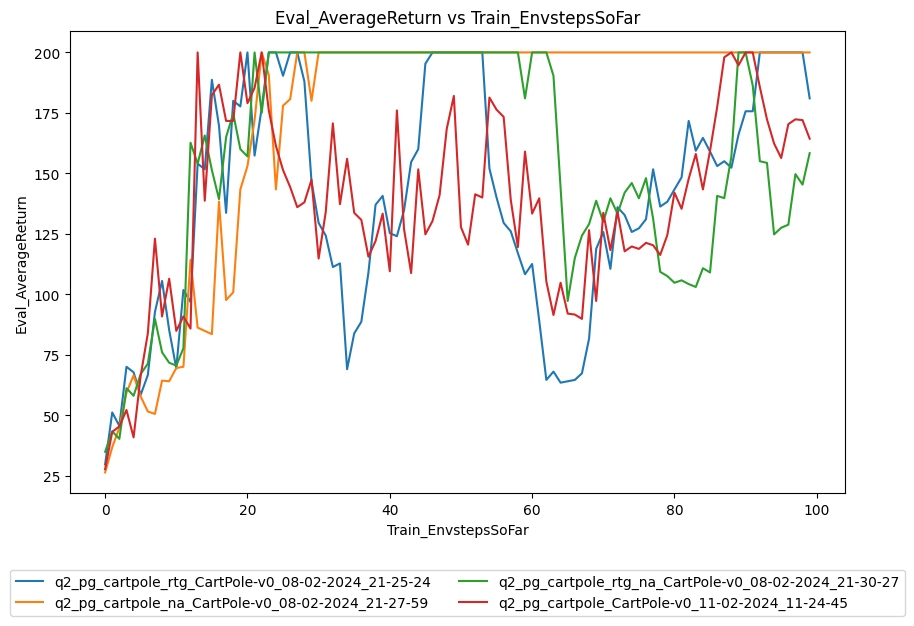

In [ ]:
plt.figure(figsize=(10, 6))


for run_folder in cartpole_small:
    event_acc = EventAccumulator(run_folder)
    event_acc.Reload()


    try:
        steps = np.array([int(s.step) for s in event_acc.Scalars('Train_EnvstepsSoFar')])
        values = np.array([s.value for s in event_acc.Scalars('Eval_AverageReturn')])

        # Plotting
        plt.plot(steps, values, label=os.path.basename(run_folder))
    except Exception as e:
        print(f"Could not retrieve data for {run_folder}: {e}")


plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), ncol=2)
plt.xlabel('Train_EnvstepsSoFar')
plt.ylabel('Eval_AverageReturn')
plt.title('Eval_AverageReturn vs Train_EnvstepsSoFar')
plt.show()

## Large batch runs

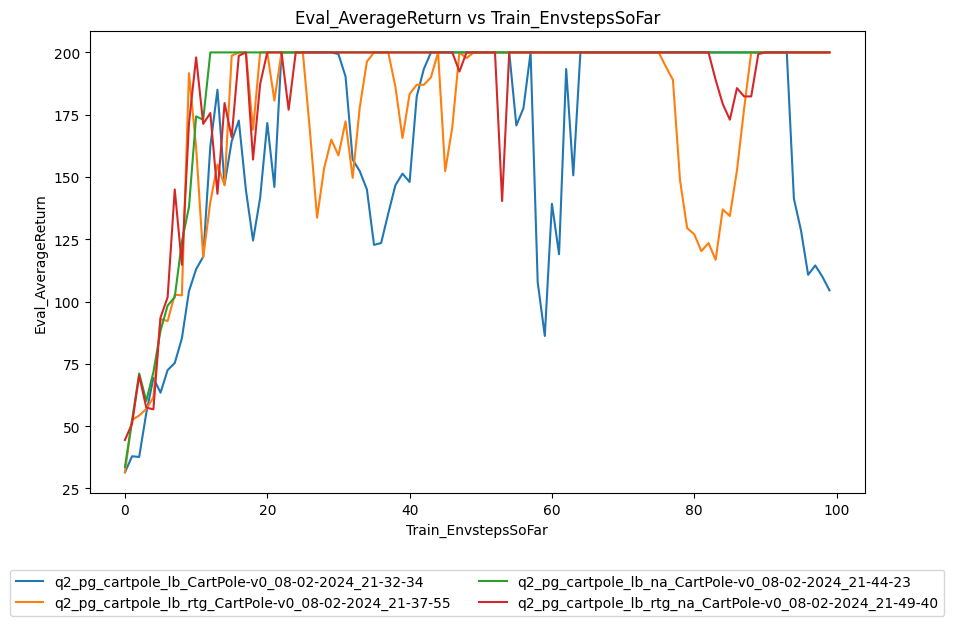

In [ ]:
plt.figure(figsize=(10, 6))

for run_folder in cartpole_large:
    event_acc = EventAccumulator(run_folder)
    event_acc.Reload()

    try:
        steps = np.array([int(s.step) for s in event_acc.Scalars('Train_EnvstepsSoFar')])
        values = np.array([s.value for s in event_acc.Scalars('Eval_AverageReturn')])

        # Plotting
        plt.plot(steps, values, label=os.path.basename(run_folder))
    except Exception as e:
        print(f"Could not retrieve data for {run_folder}: {e}")

plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), ncol=2)
plt.xlabel('Train_EnvstepsSoFar')
plt.ylabel('Eval_AverageReturn')
plt.title('Eval_AverageReturn vs Train_EnvstepsSoFar')
plt.show()

# 4. Using a Neural Network Baseline

In [ ]:
# No baseline
!python cs285/scripts/run_hw2.py --env_name HalfCheetah-v4 \
-n 100 -b 5000 -rtg --discount 0.95 -lr 0.01 \
--exp_name cheetah

########################
logging outputs to  /content/gdrive/MyDrive/cs285_f2023/homework_fall2023/hw2/cs285/scripts/../../data/q2_pg_cheetah_HalfCheetah-v4_08-02-2024_22-05-19
########################
Using GPU id 0
/usr/local/lib/python3.10/dist-packages/gym/core.py:317: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.10/dist-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(

********** Iteration 0 ************

Eval_AverageReturn : -798.2371215820312
Eval_StdReturn : 0.0
Eval_MaxReturn : -798.2371215820312
Eval_MinReturn : -798.2371215820312
Eval_Avera

In [ ]:
# Baseline
!python cs285/scripts/run_hw2.py --env_name HalfCheetah-v4 \
-n 100 -b 5000 -rtg --discount 0.95 -lr 0.01 \
--use_baseline -blr 0.01 -bgs 5 --exp_name cheetah_baseline

########################
logging outputs to  /content/gdrive/MyDrive/cs285_f2023/homework_fall2023/hw2/cs285/scripts/../../data/q2_pg_cheetah_baseline_HalfCheetah-v4_09-02-2024_12-54-00
########################
Using CPU.
/usr/local/lib/python3.10/dist-packages/gym/core.py:317: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.10/dist-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(

********** Iteration 0 ************

Eval_AverageReturn : -746.3900756835938
Eval_StdReturn : 0.0
Eval_MaxReturn : -746.3900756835938
Eval_MinReturn : -746.3900756835938
Eval_

In [ ]:
!python cs285/scripts/run_hw2.py --env_name HalfCheetah-v4 \
-n 100 -b 5000 -rtg --discount 0.95 -lr 0.01 \
--use_baseline -blr 0.01 -bgs 5 --exp_name cheetah_baseline -na

########################
logging outputs to  /content/gdrive/My Drive/cs285_f2023/homework_fall2023/hw2/cs285/scripts/../../data/q2_pg_cheetah_baseline_HalfCheetah-v4_14-02-2024_08-22-34
########################
Using GPU id 0
/usr/local/lib/python3.10/dist-packages/gym/core.py:317: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.10/dist-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(

********** Iteration 0 ************
/usr/local/lib/python3.10/dist-packages/gym/utils/passive_env_checker.py:241: DeprecationWarning: `np.bool8` is a deprecated alias for

In [ ]:
!python cs285/scripts/run_hw2.py --env_name HalfCheetah-v4 \
-n 100 -b 5000 -rtg --discount 0.95 -lr 0.01 \
--use_baseline -blr 0.005 -bgs 3 --exp_name cheetah_baseline -na

########################
logging outputs to  /content/gdrive/My Drive/cs285_f2023/homework_fall2023/hw2/cs285/scripts/../../data/q2_pg_cheetah_baseline_HalfCheetah-v4_14-02-2024_08-37-15
########################
Using GPU id 0
/usr/local/lib/python3.10/dist-packages/gym/core.py:317: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.10/dist-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(

********** Iteration 0 ************
/usr/local/lib/python3.10/dist-packages/gym/utils/passive_env_checker.py:241: DeprecationWarning: `np.bool8` is a deprecated alias for

In [ ]:
!python cs285/scripts/run_hw2.py --env_name HalfCheetah-v4 \
-n 100 -b 5000 -rtg --discount 0.95 -lr 0.01 \
--use_baseline -blr 0.01 -bgs 3 --exp_name cheetah_baseline

########################
logging outputs to  /content/gdrive/My Drive/cs285_f2023/homework_fall2023/hw2/cs285/scripts/../../data/q2_pg_cheetah_baseline_HalfCheetah-v4_14-02-2024_08-51-49
########################
Using GPU id 0
/usr/local/lib/python3.10/dist-packages/gym/core.py:317: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.10/dist-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(

********** Iteration 0 ************
/usr/local/lib/python3.10/dist-packages/gym/utils/passive_env_checker.py:241: DeprecationWarning: `np.bool8` is a deprecated alias for

In [ ]:
!python cs285/scripts/run_hw2.py --env_name HalfCheetah-v4 \
-n 100 -b 5000 -rtg --discount 0.95 -lr 0.01 \
--use_baseline -blr 0.005 -bgs 5 --exp_name cheetah_baseline

########################
logging outputs to  /content/gdrive/My Drive/cs285_f2023/homework_fall2023/hw2/cs285/scripts/../../data/q2_pg_cheetah_baseline_HalfCheetah-v4_14-02-2024_09-16-01
########################
Using GPU id 0
/usr/local/lib/python3.10/dist-packages/gym/core.py:317: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.10/dist-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(

********** Iteration 0 ************
/usr/local/lib/python3.10/dist-packages/gym/utils/passive_env_checker.py:241: DeprecationWarning: `np.bool8` is a deprecated alias for

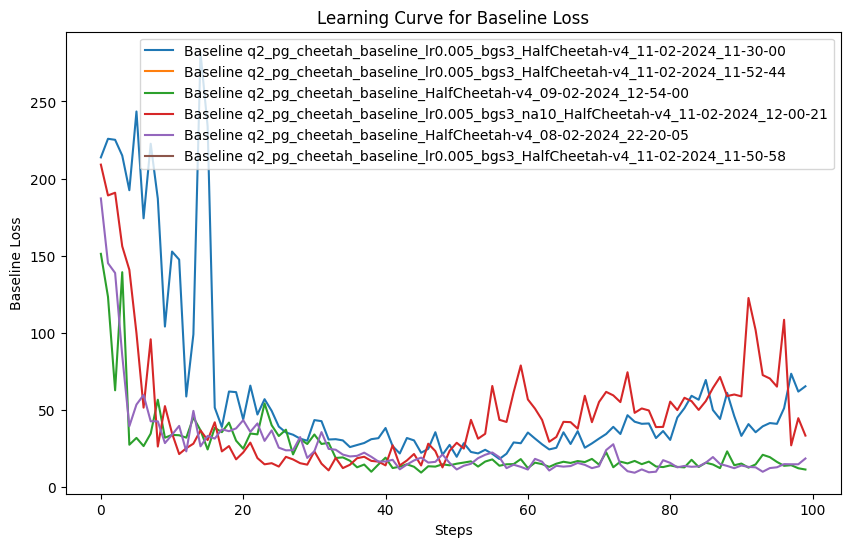

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import os
from tensorboard.backend.event_processing.event_accumulator import EventAccumulator

cheetah_experiments = [f for f in run_folders if "cheetah" in f and "baseline" not in f]
cheetah_baseline_experiments = [f for f in run_folders if "cheetah_baseline" in f]

plt.figure(figsize=(10, 6))

def plot_data_for_loss(folders, label_prefix):
    for log_folder in folders:
        event_acc = EventAccumulator(log_folder)
        event_acc.Reload()

        try:
            steps = np.array([int(s.step) for s in event_acc.Scalars('Baseline_Loss')])
            losses = np.array([s.value for s in event_acc.Scalars('Baseline_Loss')])

            plt.plot(steps, losses, label=f'{label_prefix} {os.path.basename(log_folder)}')
        except Exception as e:
            print(f"Could not retrieve data for {log_folder}: {e}")

# Plot data for experiments with baseline
plot_data_for_loss(cheetah_baseline_experiments, 'Baseline')

plt.legend()
plt.xlabel('Steps')
plt.ylabel('Baseline Loss')
plt.title('Learning Curve for Baseline Loss')
plt.show()


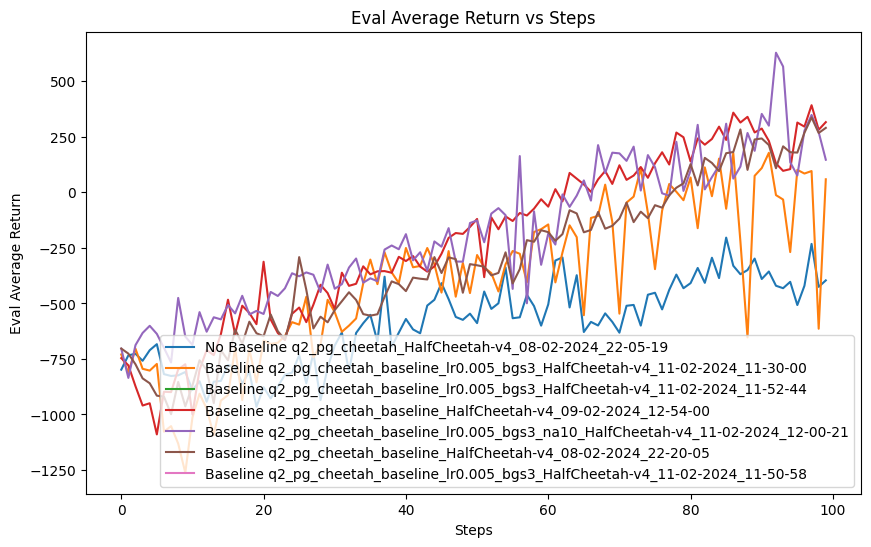

In [ ]:
plt.figure(figsize=(10, 6))

def plot_data_for_eval_return(folders, label_prefix):
    for log_folder in folders:
        event_acc = EventAccumulator(log_folder)
        event_acc.Reload()

        try:
            steps = np.array([int(s.step) for s in event_acc.Scalars('Eval_AverageReturn')])
            eval_returns = np.array([s.value for s in event_acc.Scalars('Eval_AverageReturn')])

            plt.plot(steps, eval_returns, label=f'{label_prefix} {os.path.basename(log_folder)}')
        except Exception as e:
            print(f"Could not retrieve data for {log_folder}: {e}")

# Plot data for experiments without and with baseline
plot_data_for_eval_return(cheetah_experiments, 'No Baseline')
plot_data_for_eval_return(cheetah_baseline_experiments, 'Baseline')

plt.legend()
plt.xlabel('Steps')
plt.ylabel('Eval Average Return')
plt.title('Eval Average Return vs Steps')
plt.show()


In [ ]:
!python cs285/scripts/run_hw2.py --env_name HalfCheetah-v4 \
-n 100 -b 5000 -rtg --discount 0.95 -lr 0.01 \
--use_baseline -blr 0.005 -bgs 3 --exp_name cheetah_baseline_lr0.005_bgs3

########################
logging outputs to  /content/gdrive/MyDrive/cs285_f2023/homework_fall2023/hw2/cs285/scripts/../../data/q2_pg_cheetah_baseline_lr0.005_bgs3_HalfCheetah-v4_11-02-2024_11-30-00
########################
Using GPU id 0
/usr/local/lib/python3.10/dist-packages/gym/core.py:317: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.10/dist-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(

********** Iteration 0 ************

Eval_AverageReturn : -729.8019409179688
Eval_StdReturn : 0.0
Eval_MaxReturn : -729.8019409179688
Eval_MinReturn : -729.80

In [ ]:
# changing video_log_freq to 10
class Args:

  def __getitem__(self, key):
    return getattr(self, key)

  def __setitem__(self, key, val):
    setattr(self, key, val)

  def __contains__(self, key):
    return hasattr(self, key)

  env_name = 'CartPole-v0' #@param
  exp_name = 'q1_sb_rtg_na' #@param

  #@markdown main parameters of interest
  n_iter = 100 #@param {type: "integer"}

  ## PDF will tell you how to set ep_len
  ## and discount for each environment
  ep_len = 200 #@param {type: "integer"}
  discount = 0.95 #@param {type: "number"}

  reward_to_go = True #@param {type: "boolean"}
  nn_baseline = False #@param {type: "boolean"}
  dont_standardize_advantages = False #@param {type: "boolean"}

  #@markdown batches and steps
  batch_size = 1000 #@param {type: "integer"}
  eval_batch_size = 400 #@param {type: "integer"}

  num_agent_train_steps_per_iter = 1 #@param {type: "integer"}
  learning_rate =  5e-3 #@param {type: "number"}

  #@markdown MLP parameters
  n_layers = 2 #@param {type: "integer"}
  size = 64 #@param {type: "integer"}

  #@markdown system
  save_params = False #@param {type: "boolean"}
  no_gpu = False #@param {type: "boolean"}
  which_gpu = 0 #@param {type: "integer"}
  seed = 1 #@param {type: "integer"}

  #@markdown logging
  ## default is to not log video so
  ## that logs are small enough to be
  ## uploaded to gradscope
  video_log_freq =  10#@param {type: "integer"}
  scalar_log_freq =  1#@param {type: "integer"}


args = Args()

## ensure compatibility with hw1 code
args['train_batch_size'] = args['batch_size']

if args['video_log_freq'] > 0:
  import warnings
  warnings.warn(
      '''\nLogging videos will make eventfiles too'''
      '''\nlarge for the autograder. Set video_log_freq = -1'''
      '''\nfor the runs you intend to submit.''')

<ipython-input-39-5d2db3ab7eb8>:59: UserWarning: 
Logging videos will make eventfiles too
large for the autograder. Set video_log_freq = -1
for the runs you intend to submit.
  warnings.warn(


In [ ]:
!python cs285/scripts/run_hw2.py --env_name HalfCheetah-v4 \
-n 100 -b 5000 -rtg --discount 0.95 -lr 0.01  \
--use_baseline -blr 0.005 -bgs 3 \
-na --exp_name cheetah_baseline_lr0.005_bgs3_na10

########################
logging outputs to  /content/gdrive/MyDrive/cs285_f2023/homework_fall2023/hw2/cs285/scripts/../../data/q2_pg_cheetah_baseline_lr0.005_bgs3_na10_HalfCheetah-v4_11-02-2024_12-00-21
########################
Using GPU id 0
/usr/local/lib/python3.10/dist-packages/gym/core.py:317: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.10/dist-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(

********** Iteration 0 ************

Eval_AverageReturn : -703.6728515625
Eval_StdReturn : 0.0
Eval_MaxReturn : -703.6728515625
Eval_MinReturn : -703.672

In [ ]:
!python cs285/scripts/run_hw2.py --env_name HalfCheetah-v4 \
-n 100 -b 5000 -rtg --discount 0.95 -lr 0.01  \
--use_baseline -blr 0.005 -bgs 3 \
-na --exp_name cheetah_baseline_lr0.005_bgs3_na10 --video_log_freq 10

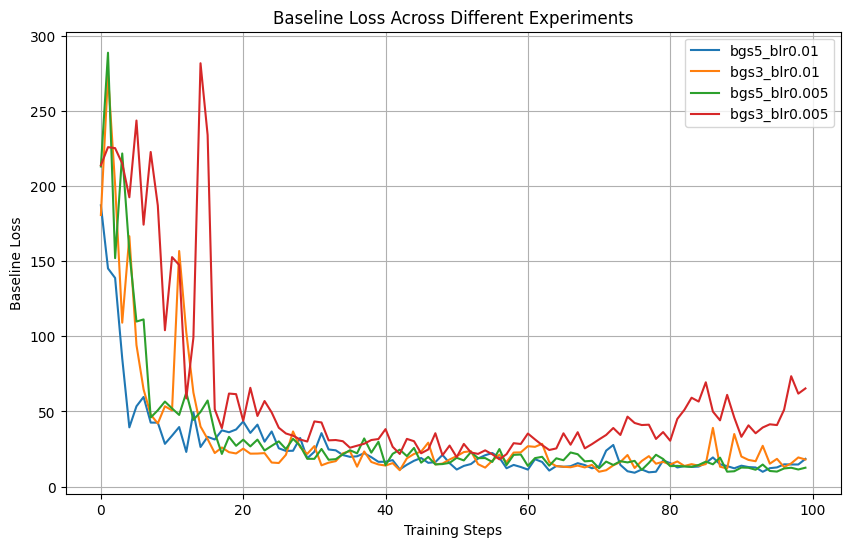

In [25]:
log_files = {
    "without_baseline": "/content/cs285_f2023/homework_fall2023/hw2/data/q2_pg_cheetah_HalfCheetah-v4_08-02-2024_22-05-19",
    "bgs5_blr0.01": "/content/cs285_f2023/homework_fall2023/hw2/data/q2_pg_cheetah_baseline_blr0.01_bgs5_HalfCheetah-v4_08-02-2024_22-20-05",
    "⁠bgs3_blr0.01": "/content/cs285_f2023/homework_fall2023/hw2/data/q2_pg_cheetah_baseline_blr0.01_bgs3_HalfCheetah-v4_14-02-2024_08-51-49",
    "⁠bgs5_blr0.005": "/content/cs285_f2023/homework_fall2023/hw2/data/q2_pg_cheetah_baseline_blr_0.005_bgs_5_HalfCheetah-v4_14-02-2024_09-16-01",
    "⁠bgs3_blr0.005": "/content/cs285_f2023/homework_fall2023/hw2/data/q2_pg_cheetah_baseline_blr0.005_bgs3_HalfCheetah-v4_11-02-2024_11-30-00"
}

plot_data = {}

for label, file_path in log_files.items():
    event_acc = EventAccumulator(file_path)
    event_acc.Reload()

    correct_key = 'Baseline_Loss'
    if correct_key in event_acc.Tags()['scalars']:
        steps = np.array([s.step for s in event_acc.Scalars(correct_key)])
        baseline_loss = np.array([s.value for s in event_acc.Scalars(correct_key)])
        plot_data[label] = (steps, baseline_loss)


plt.figure(figsize=(10, 6))

for label, (steps, baseline_loss) in plot_data.items():
    plt.plot(steps, baseline_loss, label=label)

plt.title('Baseline Loss Across Different Experiments')
plt.xlabel('Training Steps')
plt.ylabel('Baseline Loss')
plt.legend()
plt.grid(True)
plt.show()

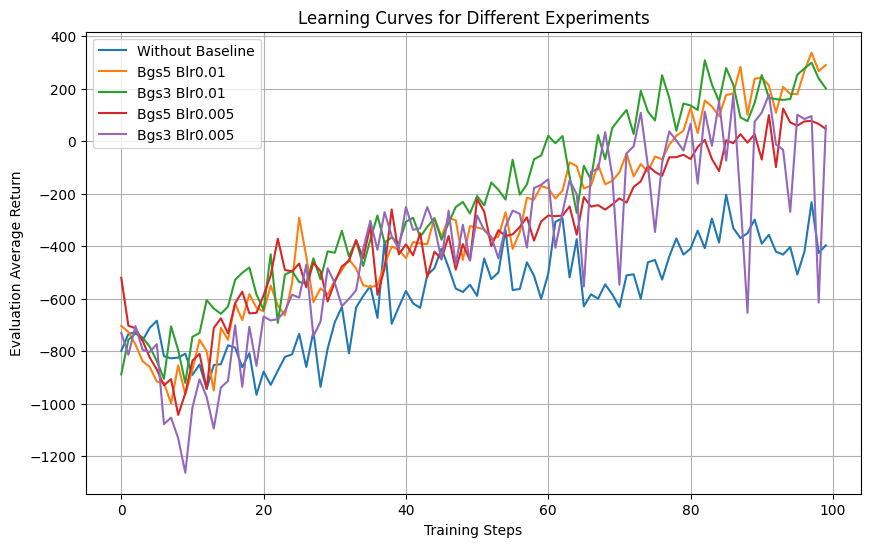

In [26]:
log_files = {
    "without_baseline": "/content/cs285_f2023/homework_fall2023/hw2/data/q2_pg_cheetah_HalfCheetah-v4_08-02-2024_22-05-19",
    "bgs5_blr0.01": "/content/cs285_f2023/homework_fall2023/hw2/data/q2_pg_cheetah_baseline_blr0.01_bgs5_HalfCheetah-v4_08-02-2024_22-20-05",
    "⁠bgs3_blr0.01": "/content/cs285_f2023/homework_fall2023/hw2/data/q2_pg_cheetah_baseline_blr0.01_bgs3_HalfCheetah-v4_14-02-2024_08-51-49",
    "⁠bgs5_blr0.005": "/content/cs285_f2023/homework_fall2023/hw2/data/q2_pg_cheetah_baseline_blr_0.005_bgs_5_HalfCheetah-v4_14-02-2024_09-16-01",
    "⁠bgs3_blr0.005": "/content/cs285_f2023/homework_fall2023/hw2/data/q2_pg_cheetah_baseline_blr0.005_bgs3_HalfCheetah-v4_11-02-2024_11-30-00"
}

plot_data = {}

for label, file_path in log_files.items():
    event_acc = EventAccumulator(file_path)
    event_acc.Reload()

    steps = np.array([s.step for s in event_acc.Scalars('Eval_AverageReturn')])
    eval_returns = np.array([s.value for s in event_acc.Scalars('Eval_AverageReturn')])

    plot_data[label] = (steps, eval_returns)

plt.figure(figsize=(10, 6))

for label, (steps, eval_returns) in plot_data.items():
    plt.plot(steps, eval_returns, label=label.replace('_', ' ').title())

plt.title('Learning Curves for Different Experiments')
plt.xlabel('Training Steps')
plt.ylabel('Evaluation Average Return')
plt.legend()
plt.grid(True)
plt.show()


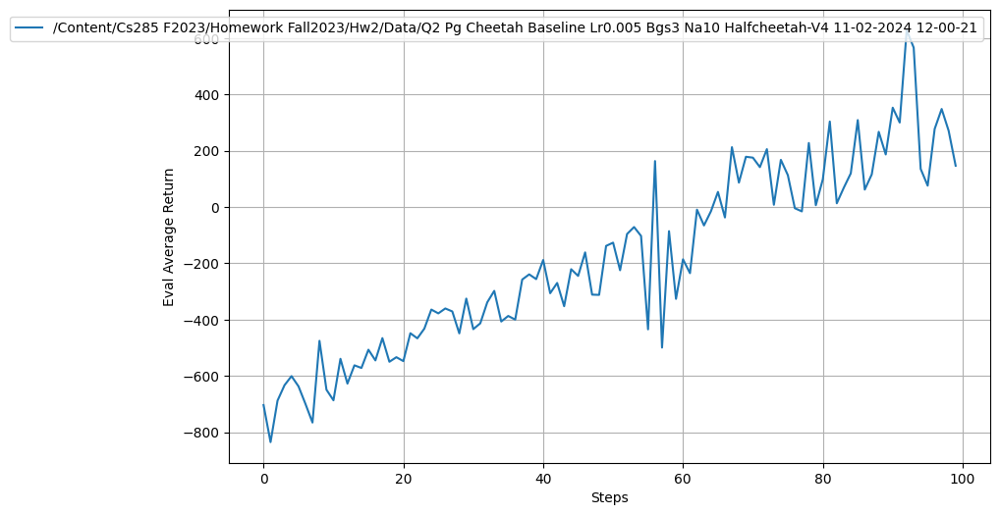

In [29]:
experiment_names = [f for f in run_folders if "cheetah_baseline_lr0.005_bgs3_na10" in f]

plt.figure(figsize=(10, 6))

for exp_name in experiment_names:
    exp_path = os.path.join(log_dir, exp_name)
    if os.path.exists(exp_path):
        event_acc = EventAccumulator(exp_path)
        event_acc.Reload()
        steps = np.array([s.step for s in event_acc.Scalars('Eval_AverageReturn')])
        eval_returns = np.array([s.value for s in event_acc.Scalars('Eval_AverageReturn')])
        plt.plot(steps, eval_returns, label=exp_name.replace('_', ' ').title())
    else:
        print(f"Directory does not exist: {exp_path}")

plt.xlabel('Steps')
plt.ylabel('Eval Average Return')
plt.legend()
plt.grid(True)

# Show the plot
plt.show()

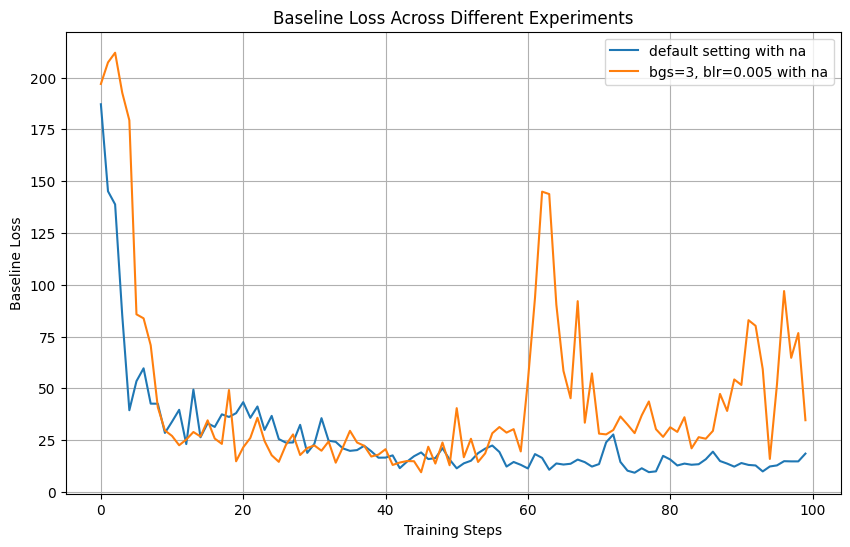

In [35]:
log_files = {
    "default setting with na": "/content/cs285_f2023/homework_fall2023/hw2/data/q2_pg_cheetah_baseline_blr0.01_bgs5_HalfCheetah-v4_08-02-2024_22-20-05",
    "bgs=3, blr=0.005 with na": "/content/cs285_f2023/homework_fall2023/hw2/data/q2_pg_cheetah_baseline_blr0.005_bgs3_na_HalfCheetah-v4_14-02-2024_08-37-15",
}

plot_data = {}

for label, file_path in log_files.items():
    event_acc = EventAccumulator(file_path)
    event_acc.Reload()

    correct_key = 'Baseline_Loss'
    if correct_key in event_acc.Tags()['scalars']:
        steps = np.array([s.step for s in event_acc.Scalars(correct_key)])
        baseline_loss = np.array([s.value for s in event_acc.Scalars(correct_key)])
        plot_data[label] = (steps, baseline_loss)
    else:
        print(f"The key {correct_key} is not found in the logs for {label}.")

plt.figure(figsize=(10, 6))

for label, (steps, baseline_loss) in plot_data.items():
    plt.plot(steps, baseline_loss, label=label)

plt.title('Baseline Loss Across Different Experiments')
plt.xlabel('Training Steps')
plt.ylabel('Baseline Loss')
plt.legend()
plt.grid(True)
plt.show()

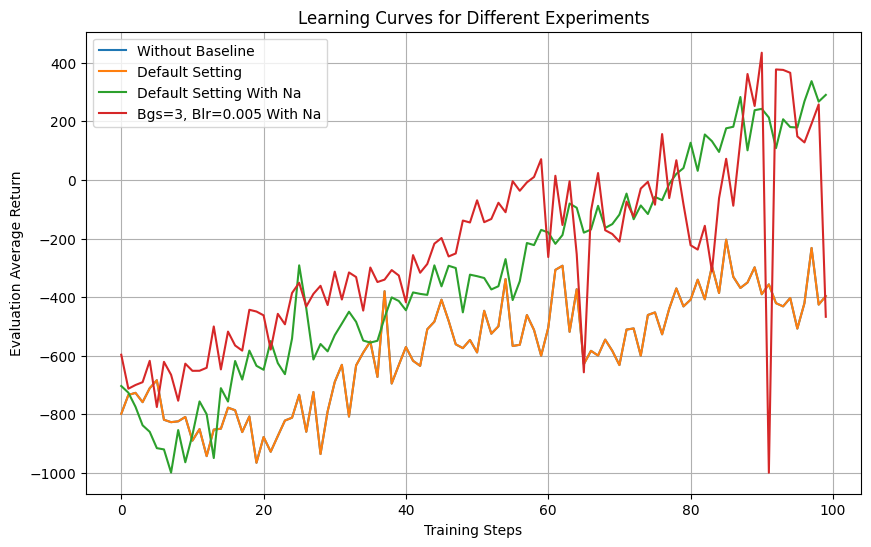

In [31]:
log_files = {
     "without_baseline": "/content/cs285_f2023/homework_fall2023/hw2/data/q2_pg_cheetah_HalfCheetah-v4_08-02-2024_22-05-19",
    "default setting": "/content/cs285_f2023/homework_fall2023/hw2/data/q2_pg_cheetah_HalfCheetah-v4_08-02-2024_22-05-19",
    "default setting with na": "/content/cs285_f2023/homework_fall2023/hw2/data/q2_pg_cheetah_baseline_blr0.01_bgs5_HalfCheetah-v4_08-02-2024_22-20-05",
    "⁠bgs=3, blr=0.005 with na": "/content/cs285_f2023/homework_fall2023/hw2/data/q2_pg_cheetah_baseline_blr0.005_bgs3_na_HalfCheetah-v4_14-02-2024_08-37-15",
}

plot_data = {}

for label, file_path in log_files.items():
    event_acc = EventAccumulator(file_path)
    event_acc.Reload()

    steps = np.array([s.step for s in event_acc.Scalars('Eval_AverageReturn')])
    eval_returns = np.array([s.value for s in event_acc.Scalars('Eval_AverageReturn')])

    plot_data[label] = (steps, eval_returns)

plt.figure(figsize=(10, 6))

for label, (steps, eval_returns) in plot_data.items():
    plt.plot(steps, eval_returns, label=label.replace('_', ' ').title())

plt.title('Learning Curves for Different Experiments')
plt.xlabel('Training Steps')
plt.ylabel('Evaluation Average Return')
plt.legend()
plt.grid(True)
plt.show()


In [ ]:
%load_ext tensorboard
%tensorboard --logdir /content/cs285_f2023/homework_fall2023/hw2/data

<IPython.core.display.Javascript object>

# 5. Implementing Generalized Advantage Estimation

Lambda = 0

In [ ]:
!python cs285/scripts/run_hw2.py --env_name LunarLander-v2 --ep_len 1000 --discount 0.99 -n 300 -l 3 -s 128 -b 2000 -lr 0.001 --use_reward_to_go --use_baseline --gae_lambda 0 --exp_name lunar_lander_lambda0

流式输出内容被截断，只能显示最后 5000 行内容。
Baseline Loss : 2832.312255859375
Train_EnvstepsSoFar : 158910
TimeSinceStart : 302.8200316429138
Done logging...



********** Iteration 73 ************

Eval_AverageReturn : -193.31634521484375
Eval_StdReturn : 25.969335556030273
Eval_MaxReturn : -173.25323486328125
Eval_MinReturn : -229.98834228515625
Eval_AverageEpLen : 209.33333333333334
Train_AverageReturn : -85.69640350341797
Train_StdReturn : 110.1241683959961
Train_MaxReturn : 132.90032958984375
Train_MinReturn : -175.83444213867188
Train_AverageEpLen : 350.5
actor_info : {'Actor Loss': array(0.03934116, dtype=float32)}
critic_info : {'Baseline Loss': array(2947.7566, dtype=float32)}
Baseline Loss : 2947.756591796875
Train_EnvstepsSoFar : 161013
TimeSinceStart : 307.5929539203644
Done logging...



********** Iteration 74 ************

Eval_AverageReturn : -26.185836791992188
Eval_StdReturn : 143.90391540527344
Eval_MaxReturn : 117.71807861328125
Eval_MinReturn : -170.08975219726562
Eval_AverageEpLen

Lambda = 0.95

In [ ]:
!python cs285/scripts/run_hw2.py --env_name LunarLander-v2 --ep_len 1000 --discount 0.99 -n 300 -l 3 -s 128 -b 2000 -lr 0.001 --use_reward_to_go --use_baseline --gae_lambda 0.95 --exp_name lunar_lander_lambda0.95

Streaming output truncated to the last 5000 lines.
Baseline Loss : 950.4381713867188
Train_EnvstepsSoFar : 159365
TimeSinceStart : 371.74055910110474
Done logging...



********** Iteration 73 ************

Eval_AverageReturn : -28.982425689697266
Eval_StdReturn : 0.0
Eval_MaxReturn : -28.982425689697266
Eval_MinReturn : -28.982425689697266
Eval_AverageEpLen : 1000.0
Train_AverageReturn : -94.18875122070312
Train_StdReturn : 4.744594573974609
Train_MaxReturn : -89.44416046142578
Train_MinReturn : -98.933349609375
Train_AverageEpLen : 1000.0
actor_info : {'Actor Loss': array(-0.6292457, dtype=float32)}
critic_info : {'Baseline Loss': array(189.60785, dtype=float32)}
Baseline Loss : 189.60784912109375
Train_EnvstepsSoFar : 161365
TimeSinceStart : 378.77236819267273
Done logging...



********** Iteration 74 ************

Eval_AverageReturn : -61.477882385253906
Eval_StdReturn : 0.0
Eval_MaxReturn : -61.477882385253906
Eval_MinReturn : -61.477882385253906
Eval_AverageEpLen : 1000.0
Train_

In [ ]:
!python cs285/scripts/run_hw2.py --env_name LunarLander-v2 --ep_len 1000 --discount 0.99 -n 300 -l 3 -s 128 -b 2000 -lr 0.001 --use_reward_to_go --use_baseline --gae_lambda 0.98 --exp_name lunar_lander_lambda0.98

Traceback (most recent call last):
  File "/content/gdrive/MyDrive/cs285_f2023/homework_fall2023/hw2/cs285/scripts/run_hw2.py", line 15, in <module>
    from cs285.infrastructure.logger import Logger
  File "/content/homework_fall2023/hw2/cs285/infrastructure/logger.py", line 2, in <module>
    from tensorboardX import SummaryWriter
ModuleNotFoundError: No module named 'tensorboardX'


Lambda = 0.98

In [ ]:
!python cs285/scripts/run_hw2.py --env_name LunarLander-v2 --ep_len 1000 --discount 0.99 -n 300 -l 3 -s 128 -b 2000 -lr 0.001 --use_reward_to_go --use_baseline --gae_lambda 0.98 --exp_name lunar_lander_lambda0.98

Streaming output truncated to the last 5000 lines.
Baseline Loss : 908.0552368164062
Train_EnvstepsSoFar : 160992
TimeSinceStart : 355.90852761268616
Done logging...



********** Iteration 73 ************

Eval_AverageReturn : 147.55714416503906
Eval_StdReturn : 0.0
Eval_MaxReturn : 147.55714416503906
Eval_MinReturn : 147.55714416503906
Eval_AverageEpLen : 1000.0
Train_AverageReturn : 25.262746810913086
Train_StdReturn : 57.02522277832031
Train_MaxReturn : 66.32608032226562
Train_MinReturn : -55.3785400390625
Train_AverageEpLen : 755.6666666666666
actor_info : {'Actor Loss': array(2.1768553, dtype=float32)}
critic_info : {'Baseline Loss': array(539.1784, dtype=float32)}
Baseline Loss : 539.1784057617188
Train_EnvstepsSoFar : 163259
TimeSinceStart : 364.18169832229614
Done logging...



********** Iteration 74 ************

Eval_AverageReturn : 102.7338638305664
Eval_StdReturn : 0.0
Eval_MaxReturn : 102.7338638305664
Eval_MinReturn : 102.7338638305664
Eval_AverageEpLen : 1000.0
Train_A

Lambda = 0.99

In [ ]:
!python cs285/scripts/run_hw2.py --env_name LunarLander-v2 --ep_len 1000 --discount 0.99 -n 300 -l 3 -s 128 -b 2000 -lr 0.001 --use_reward_to_go --use_baseline --gae_lambda 0.99 --exp_name lunar_lander_lambda0.99

Streaming output truncated to the last 5000 lines.
Baseline Loss : 1881.59375
Train_EnvstepsSoFar : 160323
TimeSinceStart : 374.3222453594208
Done logging...



********** Iteration 73 ************

Eval_AverageReturn : -9.156323432922363
Eval_StdReturn : 31.87649917602539
Eval_MaxReturn : 22.72017478942871
Eval_MinReturn : -41.03282165527344
Eval_AverageEpLen : 217.5
Train_AverageReturn : 98.14225769042969
Train_StdReturn : 14.61330795288086
Train_MaxReturn : 112.75556182861328
Train_MinReturn : 83.52894592285156
Train_AverageEpLen : 1000.0
actor_info : {'Actor Loss': array(8.743098, dtype=float32)}
critic_info : {'Baseline Loss': array(736.84875, dtype=float32)}
Baseline Loss : 736.8487548828125
Train_EnvstepsSoFar : 162323
TimeSinceStart : 380.2707271575928
Done logging...



********** Iteration 74 ************

Eval_AverageReturn : 94.64510345458984
Eval_StdReturn : 35.28279495239258
Eval_MaxReturn : 129.9279022216797
Eval_MinReturn : 59.362308502197266
Eval_AverageEpLen : 576.0
T

Lambda = 1

In [ ]:
!python cs285/scripts/run_hw2.py --env_name LunarLander-v2 --ep_len 1000 --discount 0.99 -n 300 -l 3 -s 128 -b 2000 -lr 0.001 --use_reward_to_go --use_baseline --gae_lambda 1 --exp_name lunar_lander_lambda1

Streaming output truncated to the last 5000 lines.
Baseline Loss : 1357.5302734375
Train_EnvstepsSoFar : 156553
TimeSinceStart : 290.156765460968
Done logging...



********** Iteration 73 ************

Eval_AverageReturn : 9.063163757324219
Eval_StdReturn : 0.0
Eval_MaxReturn : 9.063163757324219
Eval_MinReturn : 9.063163757324219
Eval_AverageEpLen : 1000.0
Train_AverageReturn : -33.385921478271484
Train_StdReturn : 120.36870574951172
Train_MaxReturn : 67.02899169921875
Train_MinReturn : -237.06735229492188
Train_AverageEpLen : 555.5
actor_info : {'Actor Loss': array(-3.9878511, dtype=float32)}
critic_info : {'Baseline Loss': array(2328.366, dtype=float32)}
Baseline Loss : 2328.365966796875
Train_EnvstepsSoFar : 158775
TimeSinceStart : 298.03482389450073
Done logging...



********** Iteration 74 ************

Eval_AverageReturn : 118.71795654296875
Eval_StdReturn : 0.0
Eval_MaxReturn : 118.71795654296875
Eval_MinReturn : 118.71795654296875
Eval_AverageEpLen : 1000.0
Train_AverageRetur

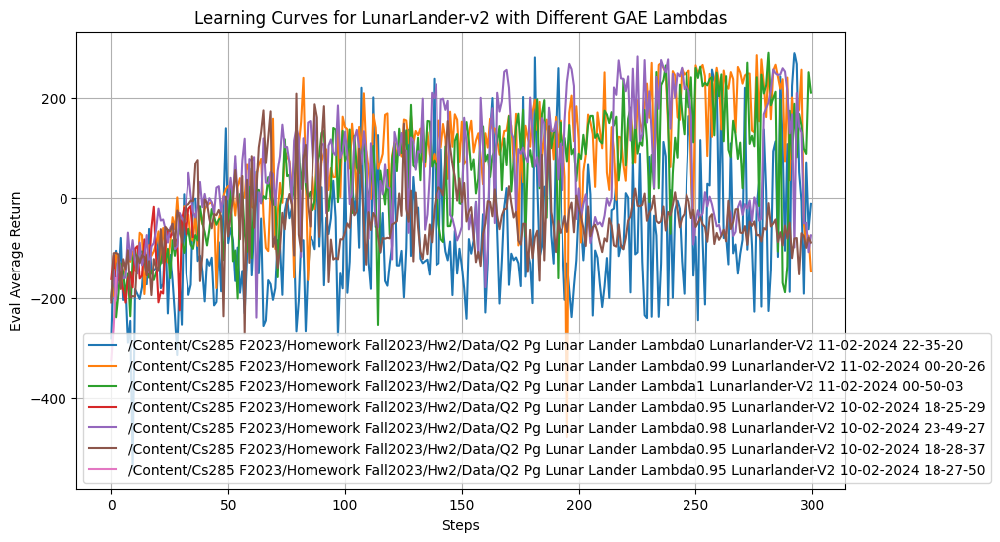

In [ ]:
experiment_names = [f for f in run_folders if "lunar_lander_lambda" in f]
plt.figure(figsize=(10, 6))
for exp_name in experiment_names:
    exp_path = os.path.join(log_dir, exp_name)
    if os.path.exists(exp_path):
        event_acc = EventAccumulator(exp_path)
        event_acc.Reload()
        steps = np.array([s.step for s in event_acc.Scalars('Eval_AverageReturn')])
        eval_returns = np.array([s.value for s in event_acc.Scalars('Eval_AverageReturn')])
        plt.plot(steps, eval_returns, label=exp_name.replace('_', ' ').title())
    else:
        print(f"Directory does not exist: {exp_path}")

plt.title('Learning Curves for LunarLander-v2 with Different GAE Lambdas')
plt.xlabel('Steps')
plt.ylabel('Eval Average Return')
plt.legend()
plt.grid(True)

# Show the plot
plt.show()


# 6. Hyperparameters and Sample Efficiency

In [ ]:
seeds = range(1, 6)
for seed in seeds:
    !python cs285/scripts/run_hw2.py --env_name InvertedPendulum-v4 -n 100 \
    --exp_name pendulum_default_s{seed} \
    -rtg --use_baseline -na \
    --batch_size 5000 \
    --seed {seed}

Streaming output truncated to the last 5000 lines.
Train_MinReturn : 97.0
Train_AverageEpLen : 566.1111111111111
actor_info : {'Actor Loss': array(-0.00438973, dtype=float32)}
critic_info : {'Baseline Loss': array(112511.34, dtype=float32)}
Baseline Loss : 112511.34375
Train_EnvstepsSoFar : 385616
TimeSinceStart : 440.3320782184601
Done logging...



********** Iteration 74 ************

Eval_AverageReturn : 1000.0
Eval_StdReturn : 0.0
Eval_MaxReturn : 1000.0
Eval_MinReturn : 1000.0
Eval_AverageEpLen : 1000.0
Train_AverageReturn : 720.5714111328125
Train_StdReturn : 259.8647155761719
Train_MaxReturn : 1000.0
Train_MinReturn : 361.0
Train_AverageEpLen : 720.5714285714286
actor_info : {'Actor Loss': array(-0.00225536, dtype=float32)}
critic_info : {'Baseline Loss': array(118375.28, dtype=float32)}
Baseline Loss : 118375.28125
Train_EnvstepsSoFar : 390660
TimeSinceStart : 447.29411578178406
Done logging...



********** Iteration 75 ************

Eval_AverageReturn : 403.0
Eval_StdReturn 

In [ ]:
for seed in seeds:
    !python cs285/scripts/run_hw2.py --env_name InvertedPendulum-v4 -n 100 \
    --exp_name pendulum_discount_hyp_search_s{seed} \
    -rtg --use_baseline -na \
    --discount 0.99 \
    --use_reward_to_go \
    --gae_lambda 0.99 \
    -s 256 \
    -l 3 \
    -lr 0.001 \
    -blr 0.002 \
    --batch_size 5000 \
    --baseline_gradient_steps 20 \
    --seed {seed}

Streaming output truncated to the last 5000 lines.
Train_MinReturn : 1000.0
Train_AverageEpLen : 1000.0
actor_info : {'Actor Loss': array(-2.6934242e-05, dtype=float32)}
critic_info : {'Baseline Loss': array(393.67084, dtype=float32)}
Baseline Loss : 393.67083740234375
Train_EnvstepsSoFar : 380514
TimeSinceStart : 494.62232065200806
Done logging...



********** Iteration 74 ************

Eval_AverageReturn : 1000.0
Eval_StdReturn : 0.0
Eval_MaxReturn : 1000.0
Eval_MinReturn : 1000.0
Eval_AverageEpLen : 1000.0
Train_AverageReturn : 1000.0
Train_StdReturn : 0.0
Train_MaxReturn : 1000.0
Train_MinReturn : 1000.0
Train_AverageEpLen : 1000.0
actor_info : {'Actor Loss': array(-0.00573759, dtype=float32)}
critic_info : {'Baseline Loss': array(394.33463, dtype=float32)}
Baseline Loss : 394.3346252441406
Train_EnvstepsSoFar : 385514
TimeSinceStart : 504.0107111930847
Done logging...



********** Iteration 75 ************

Eval_AverageReturn : 1000.0
Eval_StdReturn : 0.0
Eval_MaxReturn : 1000.0

In [ ]:
base_log_dir ="/content/cs285_f2023/homework_fall2023/hw2/data"

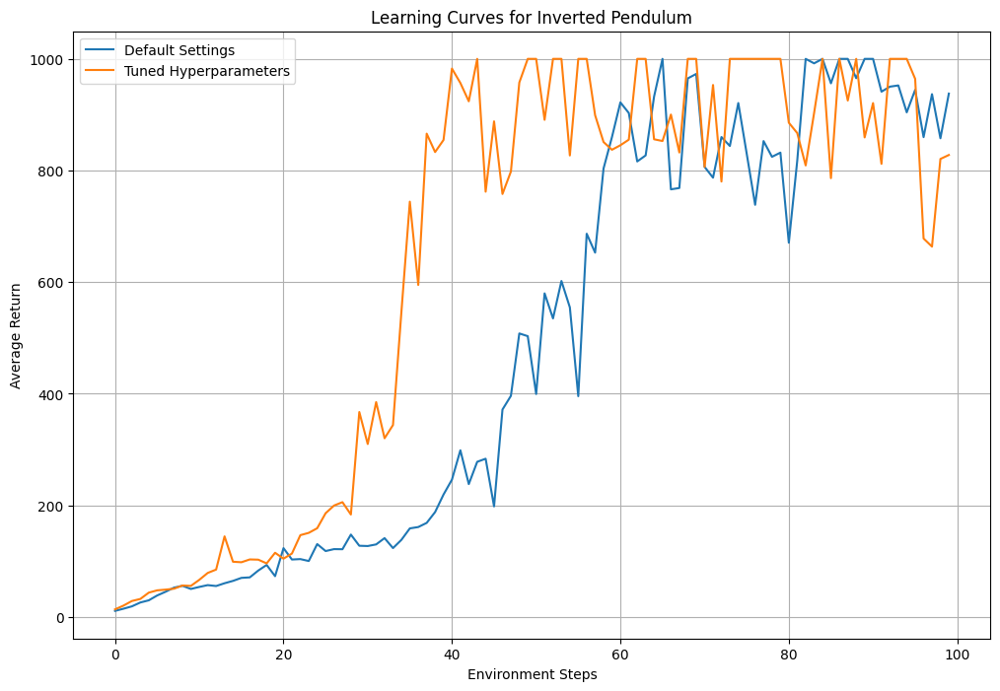

In [ ]:
def load_tensorboard_scalar_data(logdir, tag='Eval_AverageReturn'):
    event_acc = EventAccumulator(logdir)
    event_acc.Reload()
    w_times, step_nums, vals = zip(*event_acc.Scalars(tag))
    return step_nums, vals

def plot_learning_curves(data_dict, title):
    plt.figure(figsize=(12, 8))
    for label, (steps, returns) in data_dict.items():
        plt.plot(steps, returns, label=label)
    plt.xlabel('Environment Steps')
    plt.ylabel('Average Return')
    plt.title(title)
    plt.legend()
    plt.grid()
    plt.show()


default_dirs = [f for f in os.listdir(base_log_dir) if 'pendulum_default' in f]
hyp_search_dirs = [f for f in os.listdir(base_log_dir) if 'pendulum_discount_hyp_search' in f]

all_data = {}

all_runs_data = []
for dir_name in default_dirs:
    log_dir = os.path.join(base_log_dir, dir_name)
    steps, returns = load_tensorboard_scalar_data(log_dir)
    all_runs_data.append(returns)
mean_returns = np.mean(all_runs_data, axis=0)
all_data['Default Settings'] = (steps, mean_returns)

all_runs_data = []
for dir_name in hyp_search_dirs:
    log_dir = os.path.join(base_log_dir, dir_name)
    steps, returns = load_tensorboard_scalar_data(log_dir)
    all_runs_data.append(returns)
mean_returns = np.mean(all_runs_data, axis=0)
all_data['Tuned Hyperparameters'] = (steps, mean_returns)

plot_learning_curves(all_data, 'Learning Curves for Inverted Pendulum')


# 7. Extra Credit: Humanoid

In [ ]:
!python cs285/scripts/run_hw2.py \
--env_name Humanoid-v4 --ep_len 1000 \
--discount 0.99 -n 1000 -l 3 -s 256 -b 50000 -lr 0.001 \
--baseline_gradient_steps 50 \
-na --use_reward_to_go --use_baseline --gae_lambda 0.97 \
--exp_name humanoid --video_log_freq 5

流式输出内容被截断，只能显示最后 5000 行内容。



********** Iteration 544 ************

Eval_AverageReturn : 674.402099609375
Eval_StdReturn : 82.71279907226562
Eval_MaxReturn : 809.91552734375
Eval_MinReturn : 590.7603149414062
Eval_AverageEpLen : 125.75
Train_AverageReturn : 709.7177734375
Train_StdReturn : 144.4507598876953
Train_MaxReturn : 1322.9866943359375
Train_MinReturn : 347.3647155761719
Train_AverageEpLen : 130.53645833333334
actor_info : {'Actor Loss': array(0.01409831, dtype=float32)}
critic_info : {'Baseline Loss': array(781.04517, dtype=float32)}
Baseline Loss : 781.045166015625
Train_EnvstepsSoFar : 27284650
TimeSinceStart : 46501.7630918026
Done logging...



********** Iteration 545 ************

Eval_AverageReturn : 655.6356201171875
Eval_StdReturn : 141.05711364746094
Eval_MaxReturn : 894.1134033203125
Eval_MinReturn : 526.3316040039062
Eval_AverageEpLen : 121.75
Train_AverageReturn : 714.4758911132812
Train_StdReturn : 140.92169189453125
Train_MaxReturn : 1463.26953125
Train_MinRetu

In [ ]:

%load_ext tensorboard
%tensorboard --logdir /content/cs285_f2023/homework_fall2023/hw2/data

<IPython.core.display.Javascript object>